<a href="https://colab.research.google.com/github/amara929/amara929/blob/main/Copy_of_Multi_Modal_Emotion_Analysis_for_Accessible_Media_Content.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install transformers torchaudio opencv-python moviepy gTTS

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 43.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 22.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 24.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 105.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitli

In [ ]:
from transformers import pipeline

face_emotion = pipeline(
    "image-classification",
    model="Rajaram1996/FacialEmoRecog"
)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/881 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/343M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/228 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
Device set to use cuda:0


In [ ]:
voice_emotion = pipeline(
    "audio-classification",
    model="superb/hubert-large-superb-er"
)

config.json:   0%|          | 0.00/1.83k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.26G [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/212 [00:00<?, ?B/s]

Device set to use cuda:0


In [ ]:
from google.colab import files

uploaded = files.upload()
video_path = list(uploaded.keys())[0]

Saving 80bee4c945d2ac41576ab5f8eb3d34f4_1745609460383.mp4 to 80bee4c945d2ac41576ab5f8eb3d34f4_1745609460383.mp4


In [ ]:
from moviepy.editor import VideoFileClip

video = VideoFileClip(video_path)
audio_path = "audio.wav"
video.audio.write_audiofile(audio_path)

  if event.key is 'enter':



MoviePy - Writing audio in audio.wav


MoviePy - Done.


In [ ]:
import cv2
import numpy as np

def analyze_frame(frame):
    # Convert to RGB (required by Hugging Face)
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Detect emotions
    results = face_emotion(frame_rgb)

    # Annotate frame with top emotion
    top_emotion = results[0]['label']
    cv2.putText(frame, top_emotion, (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    return frame

In [ ]:
def analyze_audio(audio_path):
    results = voice_emotion(audio_path)
    top_emotion = results[0]['label']
    return f"The speaker sounds {top_emotion}."

In [ ]:
# 1. Install required packages
!pip install transformers torchaudio moviepy gTTS

# 2. Import libraries
from transformers import pipeline
from moviepy.editor import VideoFileClip
from google.colab import files
import IPython

# 3. Load voice emotion model
voice_emotion = pipeline(
    "audio-classification",
    model="superb/hubert-large-superb-er"
)

# 4. Upload video file
print("Please upload your video file (MP4, AVI, etc.):")
uploaded = files.upload()
video_filename = list(uploaded.keys())[0]

# 5. Extract audio from video
video = VideoFileClip(video_filename)
audio_filename = "extracted_audio.wav"
video.audio.write_audiofile(audio_filename, codec='pcm_s16le')

# 6. Analyze voice emotions
def analyze_video_emotion(audio_path):
    results = voice_emotion(audio_path)
    emotion_results = "\n".join([f"{res['label']}: {res['score']:.2%}" for res in results])

    # Get top emotion
    top_emotion = max(results, key=lambda x: x['score'])

    # Generate audio description
    from gtts import gTTS
    tts = gTTS(f"The predominant emotion in this scene is {top_emotion['label']}", lang='en')
    tts.save("emotion_description.mp3")

    return emotion_results, top_emotion['label']

# 7. Run analysis and show results
print("\nAnalyzing audio emotions...")
analysis, top_emo = analyze_video_emotion(audio_filename)

print("\nVOICE EMOTION ANALYSIS RESULTS:")
print(analysis)
print(f"\nMAIN EMOTION DETECTED: {top_emo}")

print("\nPlaying audio description:")
IPython.display.display(IPython.display.Audio("emotion_description.mp3"))

Device set to use cuda:0


Please upload your video file (MP4, AVI, etc.):


Saving 80bee4c945d2ac41576ab5f8eb3d34f4_1745609460383.mp4 to 80bee4c945d2ac41576ab5f8eb3d34f4_1745609460383 (1).mp4
MoviePy - Writing audio in extracted_audio.wav


MoviePy - Done.

Analyzing audio emotions...

VOICE EMOTION ANALYSIS RESULTS:
sad: 88.33%
hap: 8.78%
neu: 2.89%
ang: 0.00%

MAIN EMOTION DETECTED: sad

Playing audio description:


In [ ]:
!pip install pydub
# Split audio into 5-second chunks
from pydub import AudioSegment
audio = AudioSegment.from_wav(audio_filename)
chunks = [audio[i*5000:(i+1)*5000] for i in range(len(audio)//5000)]

for i, chunk in enumerate(chunks):
    chunk.export(f"chunk_{i}.wav", format="wav")
    results = voice_emotion(f"chunk_{i}.wav")
    print(f"Scene {i}: {results[0]['label']}")

Scene 0: sad
Scene 1: sad
Scene 2: sad
Scene 3: hap
Scene 4: sad
Scene 5: hap
Scene 6: sad
Scene 7: sad


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


Scene 8: sad
Scene 9: sad
Scene 10: hap


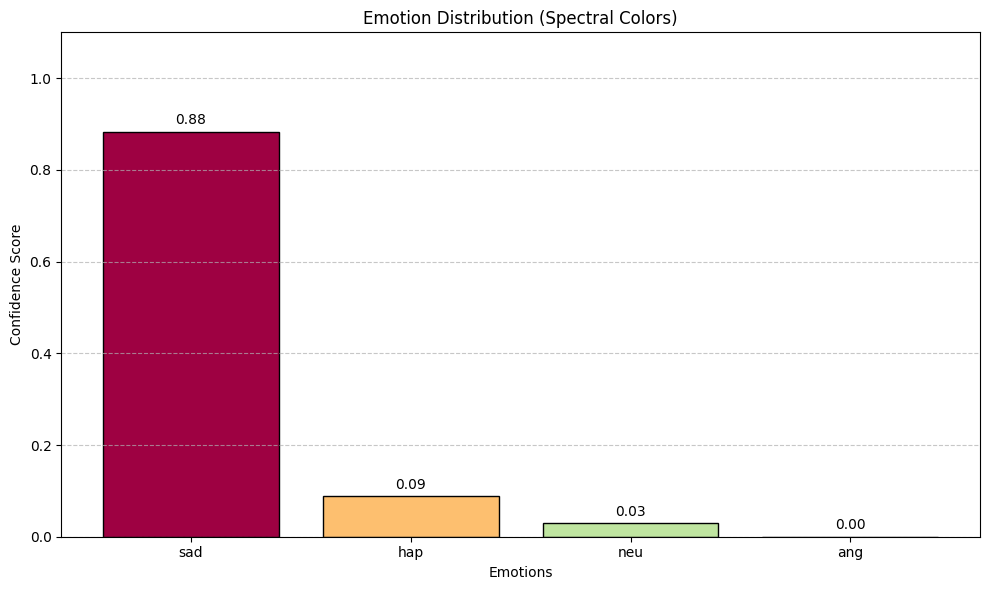

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm

# Get the results from voice_emotion
results = voice_emotion(audio_filename)

# Assuming results is a list containing a dictionary
if results and isinstance(results[0], dict):
    emotions = [res['label'] for res in results]
    scores = [res['score'] for res in results]
else:
    print("Unexpected format of results from voice_emotion")
    emotions = []
    scores = []

# Generate a color map
colors = cm.Spectral(np.linspace(0, 1, len(emotions)))

# Plotting as a histogram-style bar chart
plt.figure(figsize=(10, 6))
bars = plt.bar(emotions, scores, color=colors, edgecolor='black')

# Annotate bars with scores
for bar, score in zip(bars, scores):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.01, f'{score:.2f}', ha='center', va='bottom')

plt.title("Emotion Distribution (Spectral Colors)")
plt.xlabel("Emotions")
plt.ylabel("Confidence Score")
plt.ylim(0, 1.1)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [ ]:
pip install moviepy speechrecognition pydub

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 32.9/32.9 MB 23.4 MB/s eta 0:00:00


In [ ]:
!pip install git+https://github.com/openai/whisper.git
!pip install torch torchvision torchaudio

  Cloning https://github.com/openai/whisper.git to /tmp/pip-req-build-8e_3tcp7
  Running command git clone --filter=blob:none --quiet https://github.com/openai/whisper.git /tmp/pip-req-build-8e_3tcp7
  Resolved https://github.com/openai/whisper.git to commit 517a43ecd132a2089d85f4ebc044728a71d49f6e
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 41.8 MB/s eta 0:00:00
  Created wheel for openai-whisper: filename=openai_whisper-20240930-py3-none-any.whl size=803707 sha256=dd1c42ca46847698c36f0420f1017d292217e34944860f9d2bc170d676a69f93
  Stored in directory: /tmp/pip-ephem-wheel-cache-z4dkhwkb/wheels/1f/1d/98/9583695e6695a6ac0ad42d87511097dce5ba486647dbfecb0e
Successfully built openai-whisper


In [ ]:
import whisper
import moviepy.editor as mp

# Step 1: Extract audio from video
# video_path = "video_filename"  # Replace with the actual path to your video file
# Instead of using the placeholder, use the actual video filename from the upload:
video_path = video_filename
audio_path = "audio.wav"

video = mp.VideoFileClip(video_path)
video.audio.write_audiofile(audio_path)

# Step 2: Transcribe using Whisper
model = whisper.load_model("base")  # or "small", "medium", "large"
result = model.transcribe(audio_path)

# Print full transcription
print("\nFull transcript:\n")
print(result["text"])

# Optional: Print subtitles with timestamps
print("\nSubtitles with timestamps:\n")
for segment in result["segments"]:
    start = segment['start']
    end = segment['end']
    text = segment['text']
    print(f"[{start:.2f} - {end:.2f}] {text}")

MoviePy - Writing audio in audio.wav


MoviePy - Done.


100%|████████████████████████████████████████| 139M/139M [00:01<00:00, 103MiB/s]



Full transcript:

 Picture perfect, yeah me one who not me me working I love how we love in silence What I'm going to say now to watch on it Baby slow down the motion in my heart you the cozy commotion Why lie down the way I'm in my heart ya ha ha I wanna stick to your program Baby slow down the motion in my heart you the cozy commotion Why lie down the way I'm in my heart ya ha ha I wanna stick to your program Ooh I know you are meant for me I was meant for you This is what it feels to find you I know you are meant for me I was meant for you This is what it feels to find you Chuck it baby my lie I said boy you're my love So if you don't know that where the dead end ended up feeling ill man you're entreprises But just love as yours is you're being等一下 I know that I was meant for you I know that I was meant for you I'm excited to find you I kon't wanna stick to your program

Subtitles with timestamps:

[0.00 - 5.00]  Picture perfect, yeah me one who not me me working
[5.00 - 7.00]  I lo

In [ ]:
pip install moviepy sounddevice scipy

In [ ]:
from moviepy.editor import VideoFileClip
from google.colab import files
import IPython.display as ipd

# Upload video
uploaded = files.upload()

# Get uploaded filename
video_path = next(iter(uploaded))

# Extract audio
def extract_audio_colab(video_path, output_audio_path="extracted_audio.wav"):
    clip = VideoFileClip(video_path)
    clip.audio.write_audiofile(output_audio_path)
    return output_audio_path

audio_path = extract_audio_colab(video_path)

# Play extracted audio
ipd.Audio(audio_path)

Saving 80bee4c945d2ac41576ab5f8eb3d34f4_1745609460383.mp4 to 80bee4c945d2ac41576ab5f8eb3d34f4_1745609460383 (3).mp4
MoviePy - Writing audio in extracted_audio.wav


MoviePy - Done.


In [ ]:
import IPython.display as ipd

# Replace with your audio file name if different
ipd.Audio("extracted_audio.wav")

In [ ]:
!pip install --upgrade transformers

In [ ]:
!pip install git+https://github.com/openai/whisper.git
!pip install ffmpeg-python

import whisper
from collections import defaultdict

# Set path to your already extracted audio file
audio_path = "extracted_audio.wav"  # Replace with your actual audio filename if different

# Load Whisper model
model = whisper.load_model("medium")  # You can also try "large" for higher accuracy

# Transcribe and detect languages segment-wise
result = model.transcribe(audio_path, task='transcribe', language=None, word_timestamps=False, verbose=False)

# Aggregate durations per detected language
lang_durations = defaultdict(float)

for segment in result['segments']:
    lang = segment.get('language', 'unknown')
    duration = segment['end'] - segment['start']
    lang_durations[lang] += duration

# Compute total duration and percentages
total_duration = sum(lang_durations.values())
language_percentages = {lang: (dur / total_duration) * 100 for lang, dur in lang_durations.items()}

# Show results
print("Language Usage Percentages:")
for lang, percent in language_percentages.items():
    print(f"{lang.upper()}: {percent:.2f}%")

  Cloning https://github.com/openai/whisper.git to /tmp/pip-req-build-l942_v_d
  Running command git clone --filter=blob:none --quiet https://github.com/openai/whisper.git /tmp/pip-req-build-l942_v_d
  Resolved https://github.com/openai/whisper.git to commit 517a43ecd132a2089d85f4ebc044728a71d49f6e
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


100%|██████████████████████████████████████| 1.42G/1.42G [00:07<00:00, 215MiB/s]


Detected language: English


100%|██████████| 5884/5884 [00:05<00:00, 1125.11frames/s]

Language Usage Percentages:
UNKNOWN: 100.00%


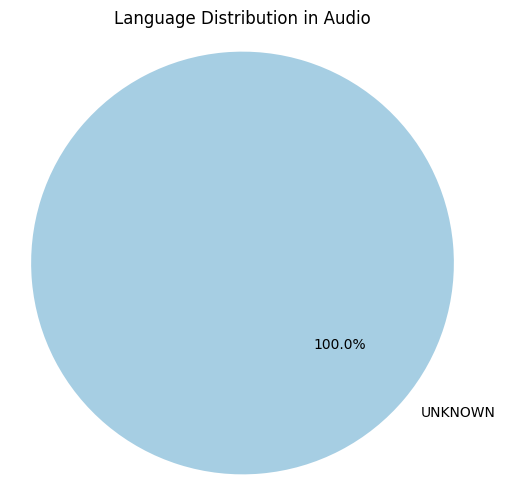

In [ ]:
import matplotlib.pyplot as plt

labels = [lang.upper() for lang in language_percentages]
sizes = list(language_percentages.values())

plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140, colors=plt.cm.Paired.colors)
plt.title("Language Distribution in Audio")
plt.axis('equal')
plt.show()

In [ ]:
!pip install transformers torchaudio librosa seaborn matplotlib

In [ ]:
# Example to print results more clearly
def print_emotion_results(results):
    for result in results:
        emotion = result['label']
        score = result['score']
        print(f"Detected Emotion: {emotion} with Confidence Score: {score:.2f}")

# Example usage
# Use the correct audio file name, which is "extracted_audio.wav"
results = detect_audio_emotions("extracted_audio.wav")
print_emotion_results(results)

Device set to use cuda:0


Results: [{'score': 0.8832985162734985, 'label': 'sad'}, {'score': 0.08782494813203812, 'label': 'hap'}, {'score': 0.028867783024907112, 'label': 'neu'}, {'score': 8.845033335092012e-06, 'label': 'ang'}]
Detected Emotion: sad with Confidence Score: 0.88
Detected Emotion: hap with Confidence Score: 0.09
Detected Emotion: neu with Confidence Score: 0.03
Detected Emotion: ang with Confidence Score: 0.00


Device set to use cuda:0


Results: [{'score': 0.8832985162734985, 'label': 'sad'}, {'score': 0.08782494813203812, 'label': 'hap'}, {'score': 0.028867783024907112, 'label': 'neu'}, {'score': 8.845033335092012e-06, 'label': 'ang'}]


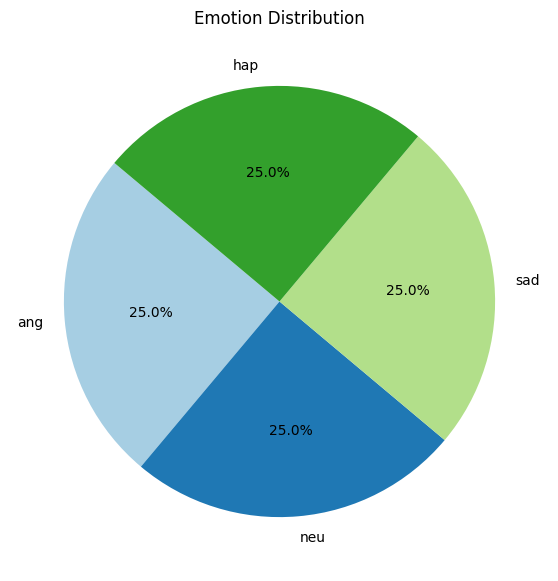

In [ ]:
import matplotlib.pyplot as plt

def plot_emotion_pie_chart(results):
    # Extract emotions and their scores
    emotions = [res['label'] for res in results]
    scores = [res['score'] for res in results]

    # Count the occurrences of each emotion
    emotion_counts = {emotion: emotions.count(emotion) for emotion in set(emotions)}

    # Plot the pie chart
    plt.figure(figsize=(7, 7))
    plt.pie(emotion_counts.values(), labels=emotion_counts.keys(), autopct='%1.1f%%', startangle=140, colors=plt.cm.Paired.colors)
    plt.title('Emotion Distribution')
    plt.show()

# Example usage
# Use the correct audio file name: "extracted_audio.wav"
results = detect_audio_emotions("extracted_audio.wav")
plot_emotion_pie_chart(results)

Device set to use cuda:0

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=emotions, y=scores, palette='viridis')



Results: [{'score': 0.8832985162734985, 'label': 'sad'}, {'score': 0.08782494813203812, 'label': 'hap'}, {'score': 0.028867783024907112, 'label': 'neu'}, {'score': 8.845033335092012e-06, 'label': 'ang'}]


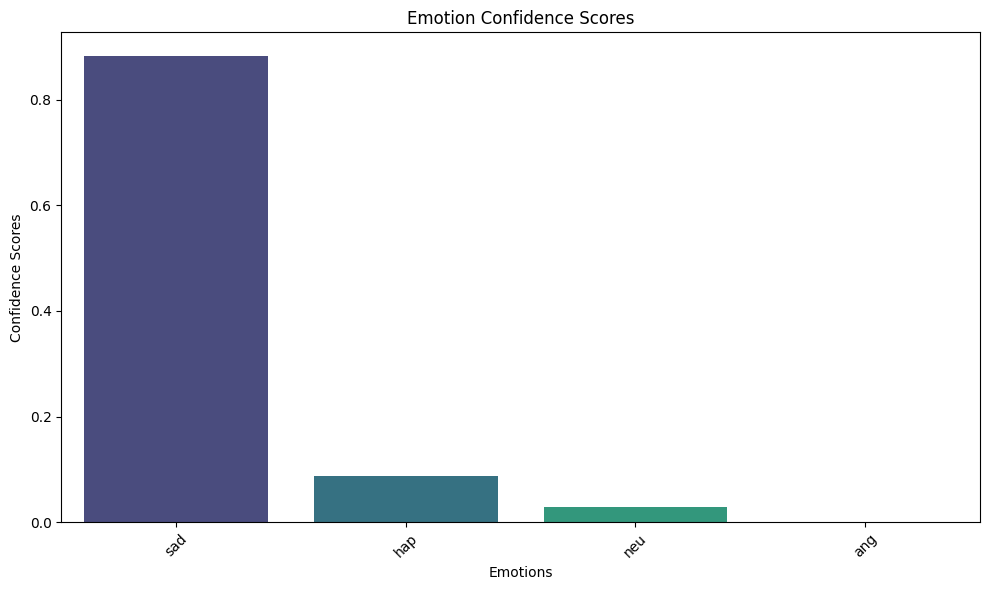

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_emotion_histogram(results):
    # Extract emotions and their scores
    emotions = [res['label'] for res in results]
    scores = [res['score'] for res in results]

    # Plot the histogram
    plt.figure(figsize=(10, 6))
    sns.barplot(x=emotions, y=scores, palette='viridis')
    plt.title('Emotion Confidence Scores')
    plt.xlabel('Emotions')
    plt.ylabel('Confidence Scores')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Example usage
# Change "path_to_audio.wav" to "extracted_audio.wav"
results = detect_audio_emotions("extracted_audio.wav")
plot_emotion_histogram(results)

In [ ]:
from moviepy.editor import VideoFileClip

def extract_audio(video_path, audio_path):
    video = VideoFileClip(video_path)
    audio = video.audio
    audio.write_audiofile(audio_path)

# Example usage
# Replace "video.mp4" with the actual video_path variable
extract_audio(video_path, "extracted_audio.wav")

MoviePy - Writing audio in extracted_audio.wav


MoviePy - Done.


In [ ]:
import whisper

def transcribe_with_whisper(audio_path):
    # Load Whisper model
    model = whisper.load_model("base")  # You can choose different model sizes like 'small', 'medium', 'large'

    # Transcribe audio
    result = model.transcribe(audio_path)

    # Print transcribed text
    print("Transcribed Text: ", result['text'])

# Example usage
transcribe_with_whisper("extracted_audio.wav")

Transcribed Text:   Picture perfect, yeah me one who not me me working I love how we love in silence What I'm going to say now to watch on it Baby slow down the motion in my heart you the cozy commotion Why lie down the way I'm in my heart ya ha ha I wanna stick to your program Baby slow down the motion in my heart you the cozy commotion Why lie down the way I'm in my heart ya ha ha I wanna stick to your program Ooh I know you are meant for me I was meant for you This is what it feels to find you I know you are meant for me I was meant for you This is what it feels to find you Chuck it baby my lie I said boy you're my love You need this light You need this light I know you are meant for me
